# Movie Review Visualization

In [1]:
from utils import *
import pandas as pd
import numpy as np
from wordcloud import WordCloud
import seaborn as sns
from matplotlib import pyplot as plt
%matplotlib inline

## Data Import

In [2]:
out_path = "./pickles/"
NUM_OF_PROCESSES = 8
preprocessed_df = merge_pickle_dfs('preprocessed_', NUM_OF_PROCESSES, out_path)

In [3]:
df = preprocessed_df.drop(preprocessed_df.columns[0], axis=1)
df.head()

,movie,reviewer,review,score,cleaned_review
0,HOTEL TRANSYLVANIA: TRANSFORMANIA,James Luxford,I guess its always been hard for me to see the...,40.0,guess always hard see positive side things dra...
1,HOTEL TRANSYLVANIA: TRANSFORMANIA,Mat Brunet,Hotel Transylvania: Transformania is a present...,30.0,presentation everything thats wrong hotel tran...
2,HOTEL TRANSYLVANIA: TRANSFORMANIA,Robert Levin,The conceit still works well enough to mostly ...,75.0,conceit still works well enough mostly distrac...
3,HOTEL TRANSYLVANIA: TRANSFORMANIA,Jackie K. Cooper,"No Adam Sandler this time out, but the animate...",60.0,adam sandler time animated fun still
4,HOTEL TRANSYLVANIA: TRANSFORMANIA,Asher Luberto,It's not likely we'll see another one of these...,74.0,likely see another one things ask another stay...


In [4]:
## top reviewers
top_critics = pd.read_csv("./raw_datasets/rt_top_critics.csv", header=None)
top_critics = top_critics[0].tolist()

In [5]:
## check overlapping of our list and the dataset
def intersection(lst1, lst2):
    lst3 = [value for value in lst1 if value in lst2]
    return lst3

print("top critics: ",len( top_critics ))
print("all reviewers: ", len(df.reviewer.unique()))
print("intersections: ",len( intersection(top_critics, df.reviewer.unique()) ))

top critics:  174
all reviewers:  5736
intersections:  144


In [6]:
df['top_critics'] = [name in top_critics for name in df['reviewer']]
df.head()

,movie,reviewer,review,score,cleaned_review,top_critics
0,HOTEL TRANSYLVANIA: TRANSFORMANIA,James Luxford,I guess its always been hard for me to see the...,40.0,guess always hard see positive side things dra...,False
1,HOTEL TRANSYLVANIA: TRANSFORMANIA,Mat Brunet,Hotel Transylvania: Transformania is a present...,30.0,presentation everything thats wrong hotel tran...,False
2,HOTEL TRANSYLVANIA: TRANSFORMANIA,Robert Levin,The conceit still works well enough to mostly ...,75.0,conceit still works well enough mostly distrac...,False
3,HOTEL TRANSYLVANIA: TRANSFORMANIA,Jackie K. Cooper,"No Adam Sandler this time out, but the animate...",60.0,adam sandler time animated fun still,False
4,HOTEL TRANSYLVANIA: TRANSFORMANIA,Asher Luberto,It's not likely we'll see another one of these...,74.0,likely see another one things ask another stay...,False


## General Visualization

D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


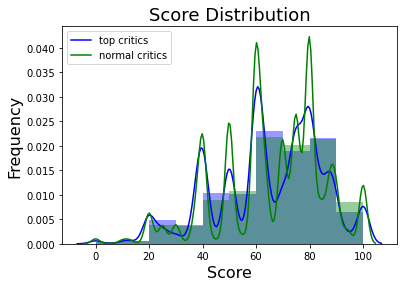

In [7]:
sns.distplot(df[df.top_critics==True]['score'], bins=10, color='b')
sns.distplot(df[df.top_critics==False]['score'], bins=10, color='g')
plt.title('Score Distribution', fontsize=18)
plt.xlabel('Score', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['top critics','normal critics'])
## no difference between top critics and others

In [8]:
stats = df.groupby("movie").agg({"score":["count","mean"]})
stats.columns = list(map('_'.join, stats.columns.values))
stats = stats.sort_values("score_count", axis = 0, ascending = False)
stats.head(10)

,score_count,score_mean
movie,,
JOKER,380,73.515789
CAPTAIN MARVEL,373,69.947721
ONCE UPON A TIME... IN HOLLYWOOD,372,80.241458
AVENGERS: ENDGAME,370,82.775676
US,358,80.053911
STAR WARS: THE RISE OF SKYWALKER,351,63.195185
A STAR IS BORN,340,81.327171
BLACK PANTHER,339,83.252025
AVENGERS: INFINITY WAR,329,77.521363


D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0, 0.5, 'Frequency')

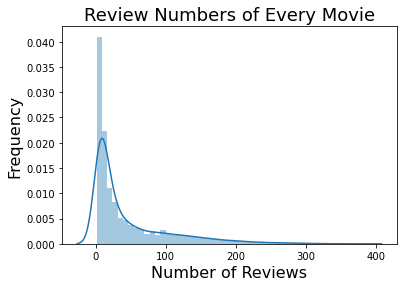

In [9]:
sns.distplot(stats['score_count'])
# sns.histplot(df['score'],bins=10)
plt.title('Review Numbers of Every Movie', fontsize=18)
plt.xlabel('Number of Reviews', fontsize=16)
plt.ylabel('Frequency', fontsize=16)

D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


Text(0, 0.5, 'Frequency')

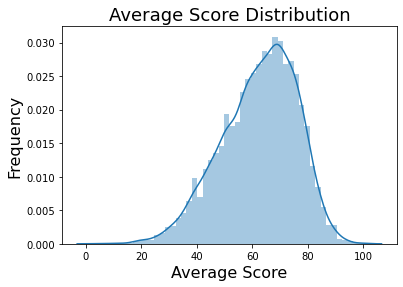

In [10]:
sns.distplot(stats['score_mean'])
# sns.histplot(df['score'],bins=10)
plt.title('Average Score Distribution', fontsize=18)
plt.xlabel('Average Score', fontsize=16)
plt.ylabel('Frequency', fontsize=16)

In [11]:
## group by top critics
stats_top = df.groupby(['movie', 'top_critics'])['score'].count().unstack().fillna(0)
stats_top.columns = ["normal reviewers","top critics"]
stats_top["total"] = stats_top.sum(axis=1)
stats_top.sort_values("total", axis = 0, ascending = False, inplace=True)
stats_top.iloc[:,:2].head()

,normal reviewers,top critics
movie,,
JOKER,348.0,32.0
CAPTAIN MARVEL,343.0,30.0
ONCE UPON A TIME... IN HOLLYWOOD,341.0,31.0
AVENGERS: ENDGAME,342.0,28.0
US,328.0,30.0


Text(0.5, 0, 'Number of Reviews')

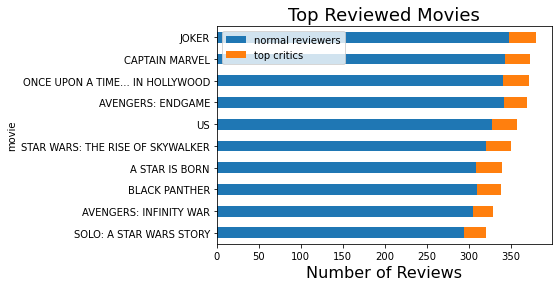

In [12]:
col_map1 = plt.get_cmap('Blues')(np.linspace(0.7, 0.3, 10))

stats_top.iloc[:10,:2].plot(kind='barh', stacked=True).invert_yaxis()
# stats.score_count[:10].plot(kind='barh',color=col_map1).invert_yaxis()
plt.title('Top Reviewed Movies', fontsize=18)
plt.xlabel('Number of Reviews', fontsize=16)

## Text Mining

### 1. word count

In [13]:
## word count
## function from lecture
df["word_count"] = df.review.apply(count_fun)
df["word_count_unique"] = df.review.apply(count_fun_unique)
df.head()

,movie,reviewer,review,score,cleaned_review,top_critics,word_count,word_count_unique
0,HOTEL TRANSYLVANIA: TRANSFORMANIA,James Luxford,I guess its always been hard for me to see the...,40.0,guess always hard see positive side things dra...,False,42,37
1,HOTEL TRANSYLVANIA: TRANSFORMANIA,Mat Brunet,Hotel Transylvania: Transformania is a present...,30.0,presentation everything thats wrong hotel tran...,False,27,24
2,HOTEL TRANSYLVANIA: TRANSFORMANIA,Robert Levin,The conceit still works well enough to mostly ...,75.0,conceit still works well enough mostly distrac...,False,15,15
3,HOTEL TRANSYLVANIA: TRANSFORMANIA,Jackie K. Cooper,"No Adam Sandler this time out, but the animate...",60.0,adam sandler time animated fun still,False,13,13
4,HOTEL TRANSYLVANIA: TRANSFORMANIA,Asher Luberto,It's not likely we'll see another one of these...,74.0,likely see another one things ask another stay...,False,23,22


D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


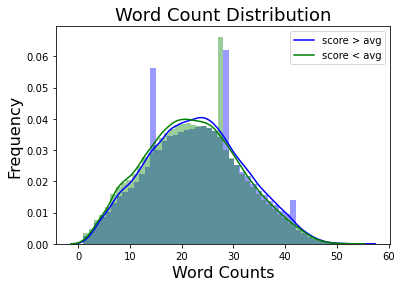

In [14]:
## word count frequency
avg = df['score'].mean()

sns.distplot(df[df['score']>=avg]["word_count"], color='b')
sns.distplot(df[df['score']<avg]["word_count"], color='g')
plt.title('Word Count Distribution', fontsize=18)
plt.xlabel('Word Counts', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['score > avg','score < avg'])

D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)
D:\Program Files (x86)\anaconda3\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


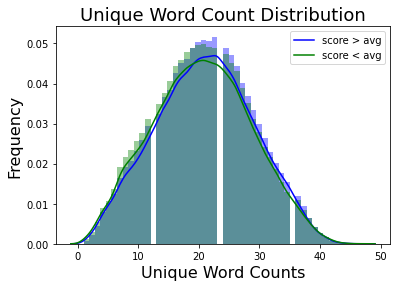

In [15]:
## unique word count frequency
avg = df['score'].mean()

sns.distplot(df[df['score']>=avg]["word_count_unique"], color='b')
sns.distplot(df[df['score']<avg]["word_count_unique"], color='g')
plt.title('Unique Word Count Distribution', fontsize=18)
plt.xlabel('Unique Word Counts', fontsize=16)
plt.ylabel('Frequency', fontsize=16)
plt.legend(['score > avg','score < avg'])

### 2. Word Frequency

In [16]:
## the wordcloud image is saved to the directory "wordcloud"
## notebook preview provided
def wordcloud(method, df_in, col_lab, col_text, movies):
    from wordcloud import WordCloud
    from matplotlib import pyplot as plt
    from sklearn.feature_extraction.text import TfidfVectorizer
    
#     sns.set()
    plt.rcParams['figure.figsize'] = [50, 40]
    
    x, y = np.ogrid[:900, :900]
    mask = (x - 450) ** 2 + (y - 450) ** 2 > 390 ** 2
    mask = 255 * mask.astype(int)

    wordcloud = WordCloud(background_color="white", mask=mask, # contour_width=0, contour_color="black",
                          max_font_size=150, random_state=42,
                          colormap="Dark2")

    for i, movie in enumerate(movies):
        tmp = df_in[df_in[col_lab] == movie]
        
        if method == "freq":
            tmp_concat = tmp[col_text].str.cat(sep=" ")
            wordcloud.generate(text=tmp_concat)
        elif method == "tf-idf":
            ## completing
            cv = TfidfVectorizer()
            tfidf = cv.fit_transform(tmp[col_text])
            sum_tf = pd.DataFrame(tfidf.sum(axis=0))
            sum_tf.columns = cv.get_feature_names()
            
            wordcloud.generate_from_frequencies(sum_tf.T[0])
        else:
            return "method not applicable"
        
        wordcloud.to_file(f'./wordcloud/{method}_{movie}.png')
#         plt.subplot(4, 1, i+1)
        plt.imshow(wordcloud, interpolation="bilinear")
        plt.axis("off")
        plt.title(movie)
        plt.show()

#### 2.1. word frequency per movie

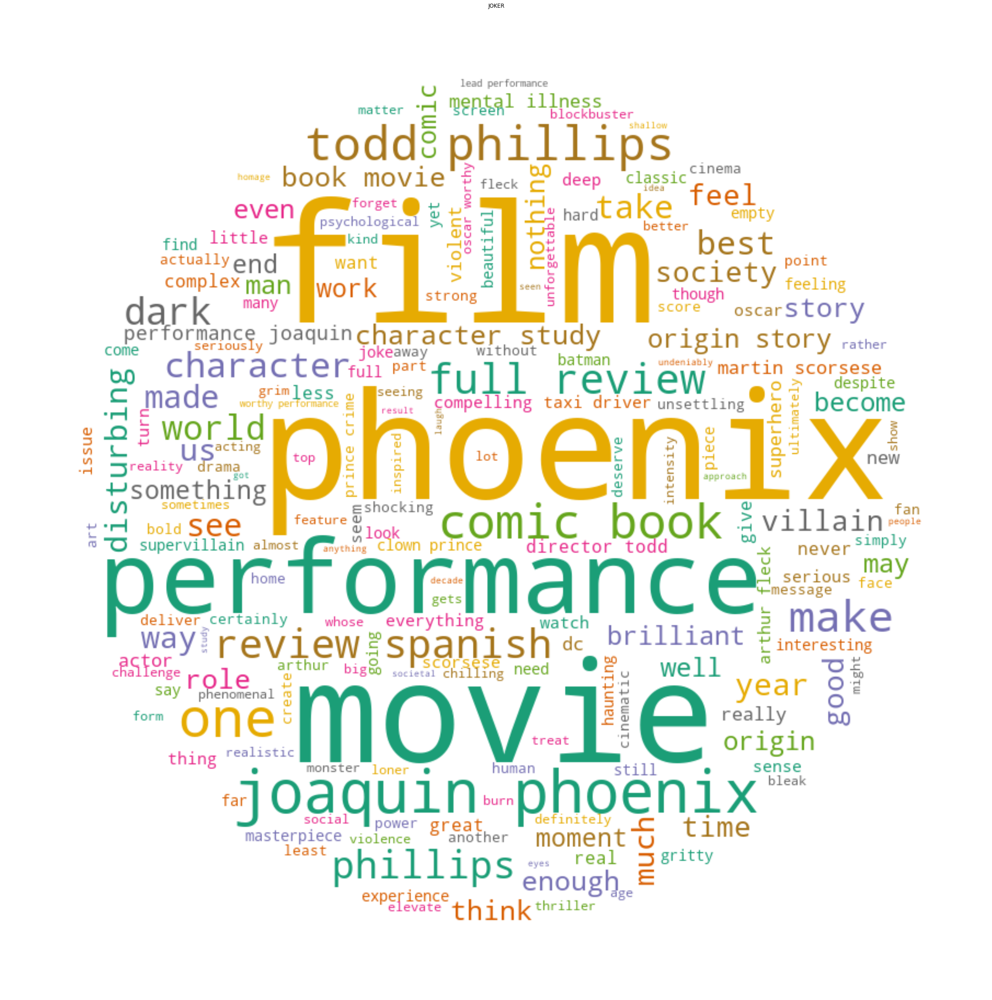

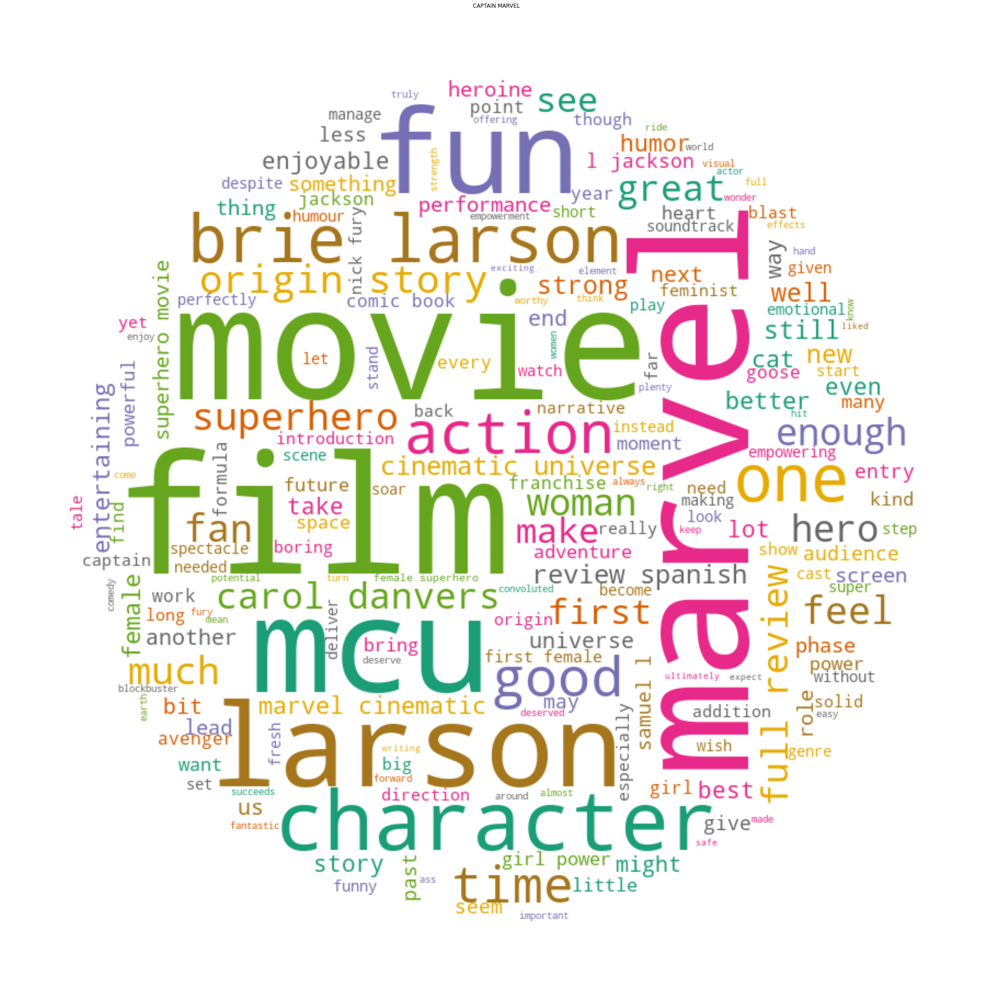

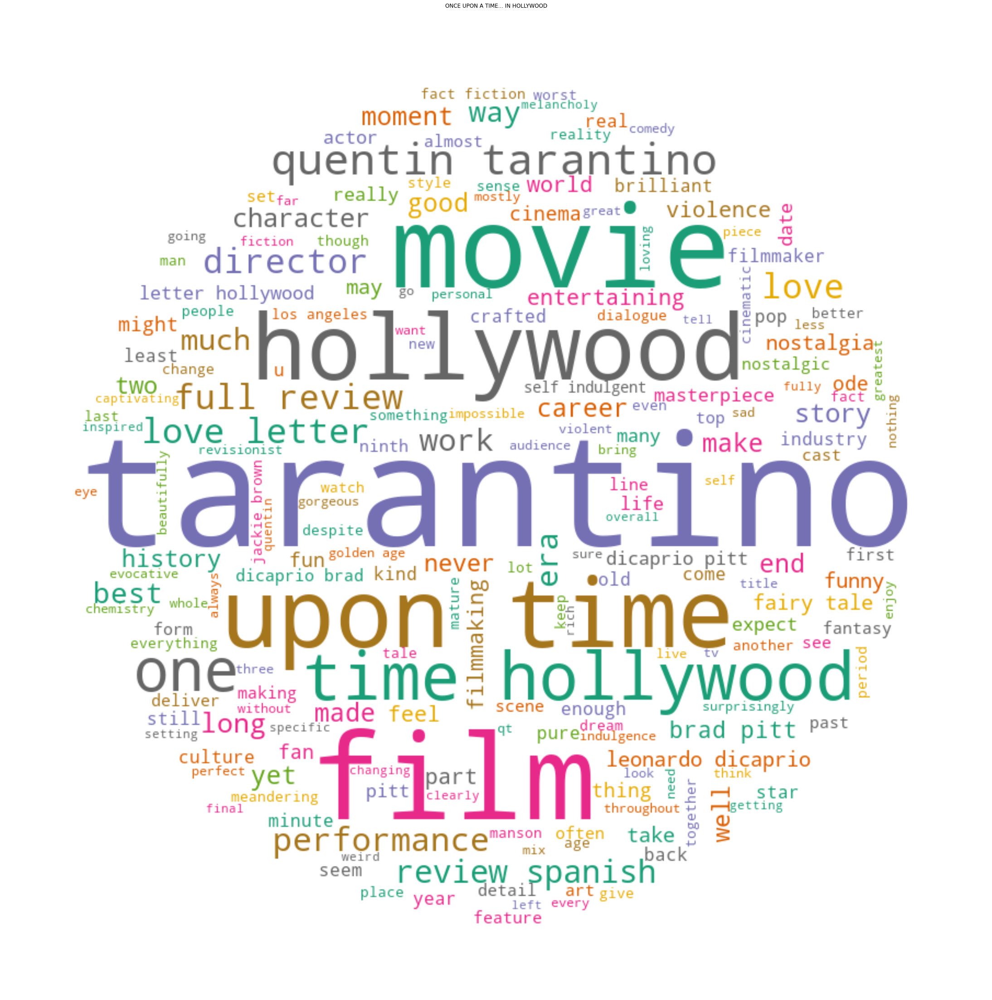

In [17]:
### you can change the content of movie_list to generate wordcloud for different movies
movie_list = stats.index[:3].tolist()
wordcloud("freq",df,"movie","cleaned_review",movie_list)

#### 2.2. word frequency per score interval

In [18]:
from bisect import bisect_left
def score_interval(score, 
                   breakpoints=[20,40,60,80], 
                   target=["0-20","20-40","40-60","60-80","80-100"]):
    i = bisect_left(breakpoints, score)
    return target[i]

In [19]:
df["score_interval"] = df.score.apply(score_interval)
df.head()

,movie,reviewer,review,score,cleaned_review,top_critics,word_count,word_count_unique,score_interval
0,HOTEL TRANSYLVANIA: TRANSFORMANIA,James Luxford,I guess its always been hard for me to see the...,40.0,guess always hard see positive side things dra...,False,42,37,20-40
1,HOTEL TRANSYLVANIA: TRANSFORMANIA,Mat Brunet,Hotel Transylvania: Transformania is a present...,30.0,presentation everything thats wrong hotel tran...,False,27,24,20-40
2,HOTEL TRANSYLVANIA: TRANSFORMANIA,Robert Levin,The conceit still works well enough to mostly ...,75.0,conceit still works well enough mostly distrac...,False,15,15,60-80
3,HOTEL TRANSYLVANIA: TRANSFORMANIA,Jackie K. Cooper,"No Adam Sandler this time out, but the animate...",60.0,adam sandler time animated fun still,False,13,13,40-60
4,HOTEL TRANSYLVANIA: TRANSFORMANIA,Asher Luberto,It's not likely we'll see another one of these...,74.0,likely see another one things ask another stay...,False,23,22,60-80


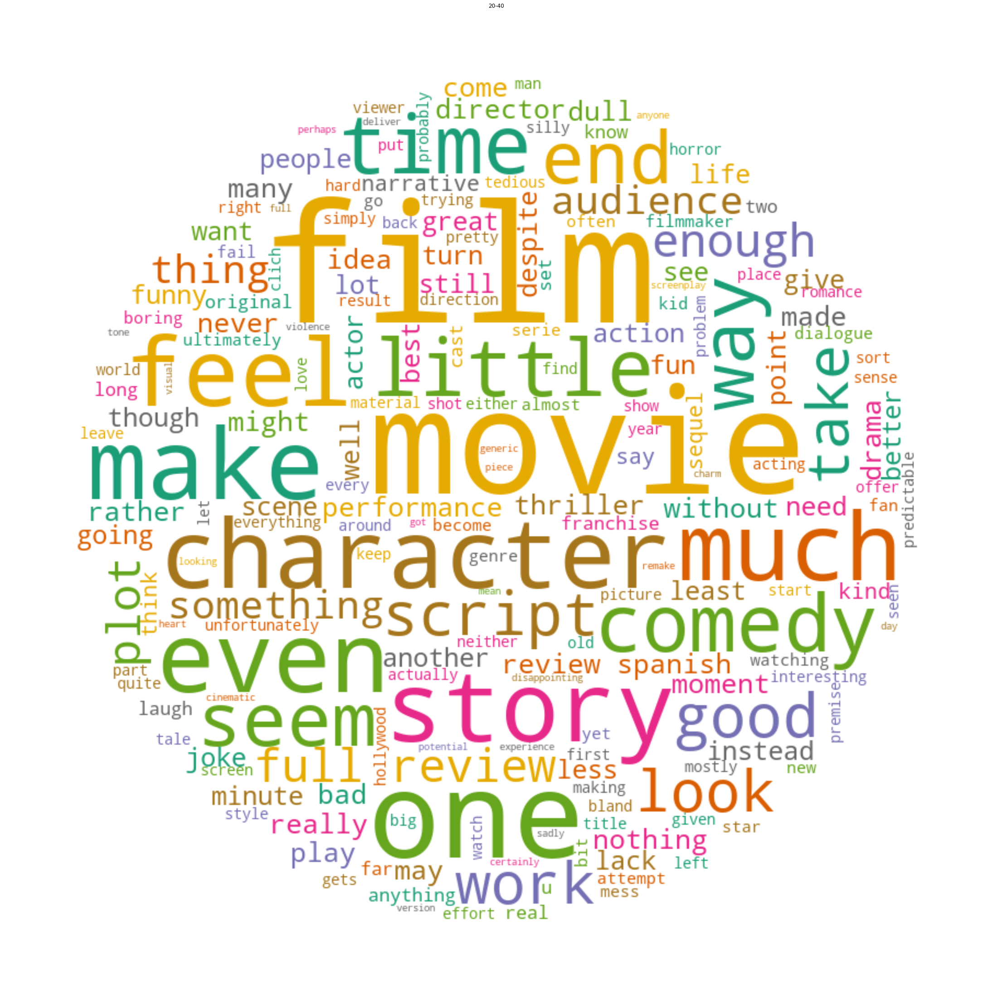

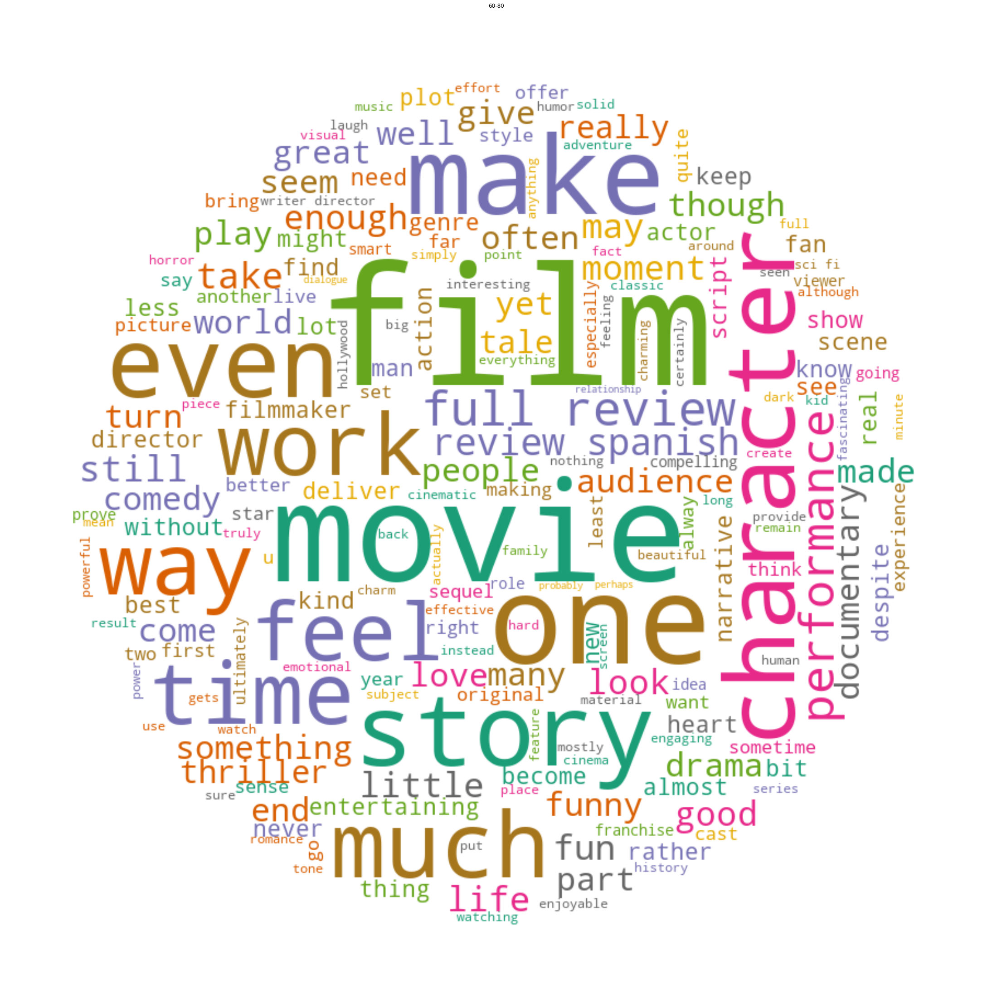

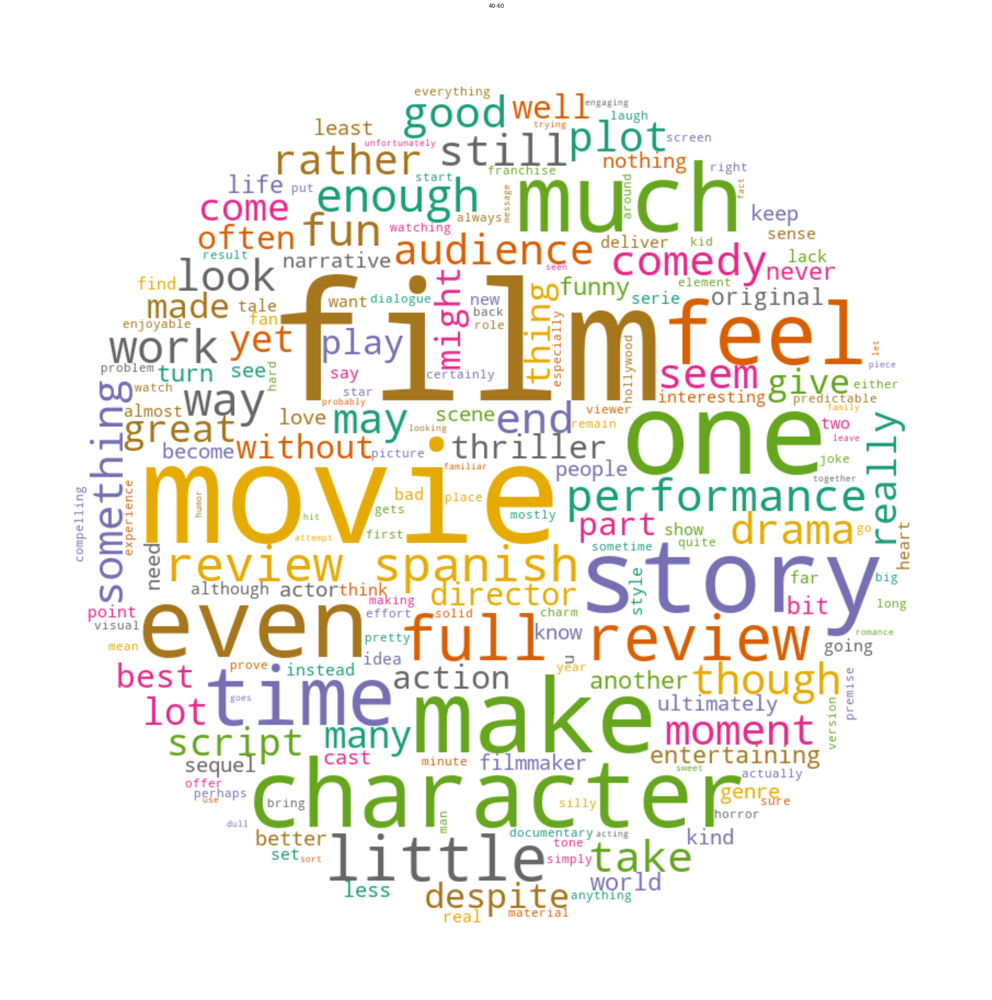

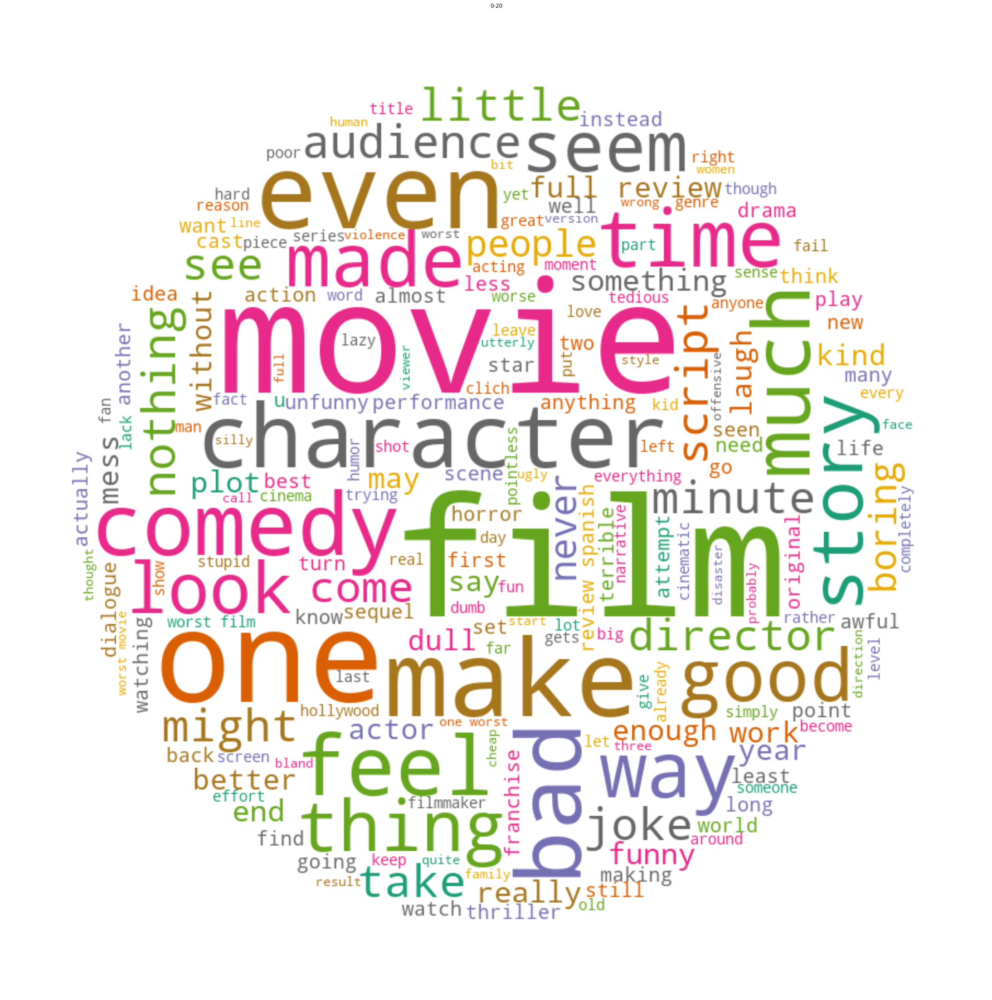

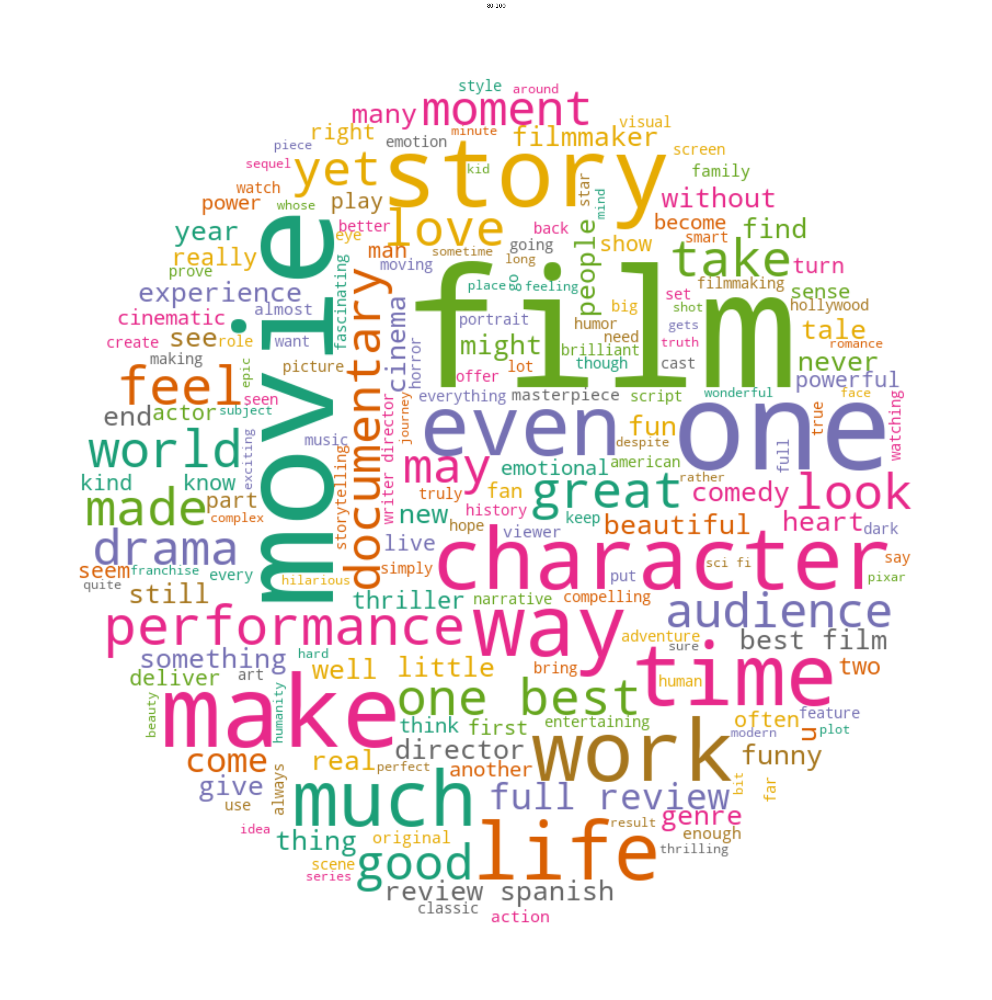

In [20]:
score_int = df.score_interval.unique()
wordcloud("freq", df, "score_interval", "cleaned_review", score_int)

#### 2.3. others

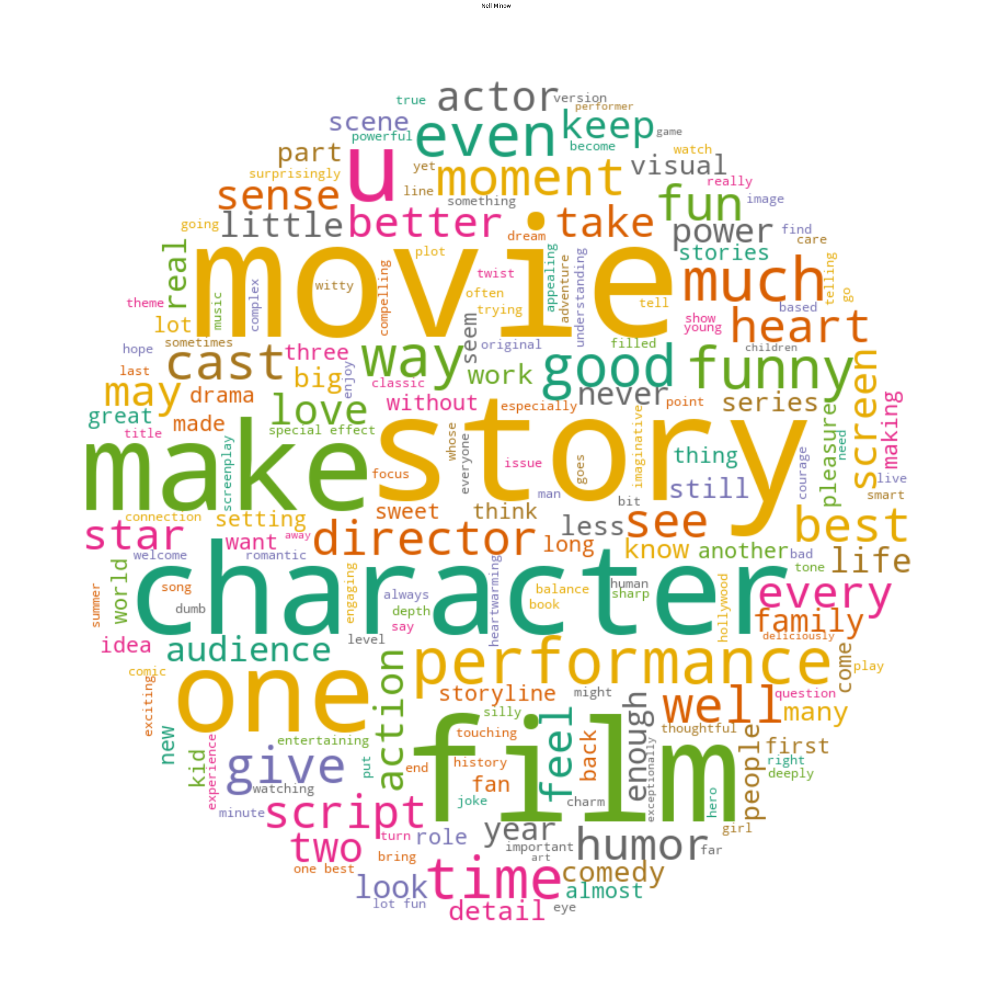

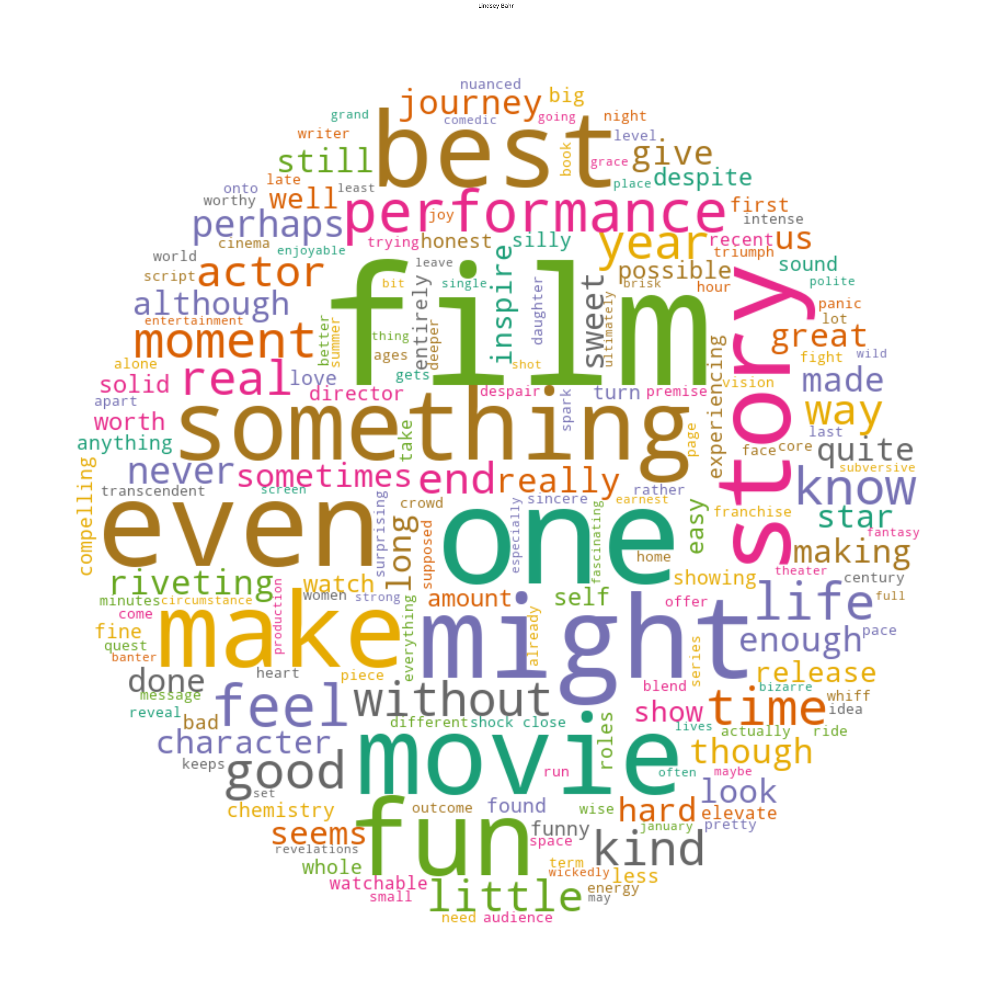

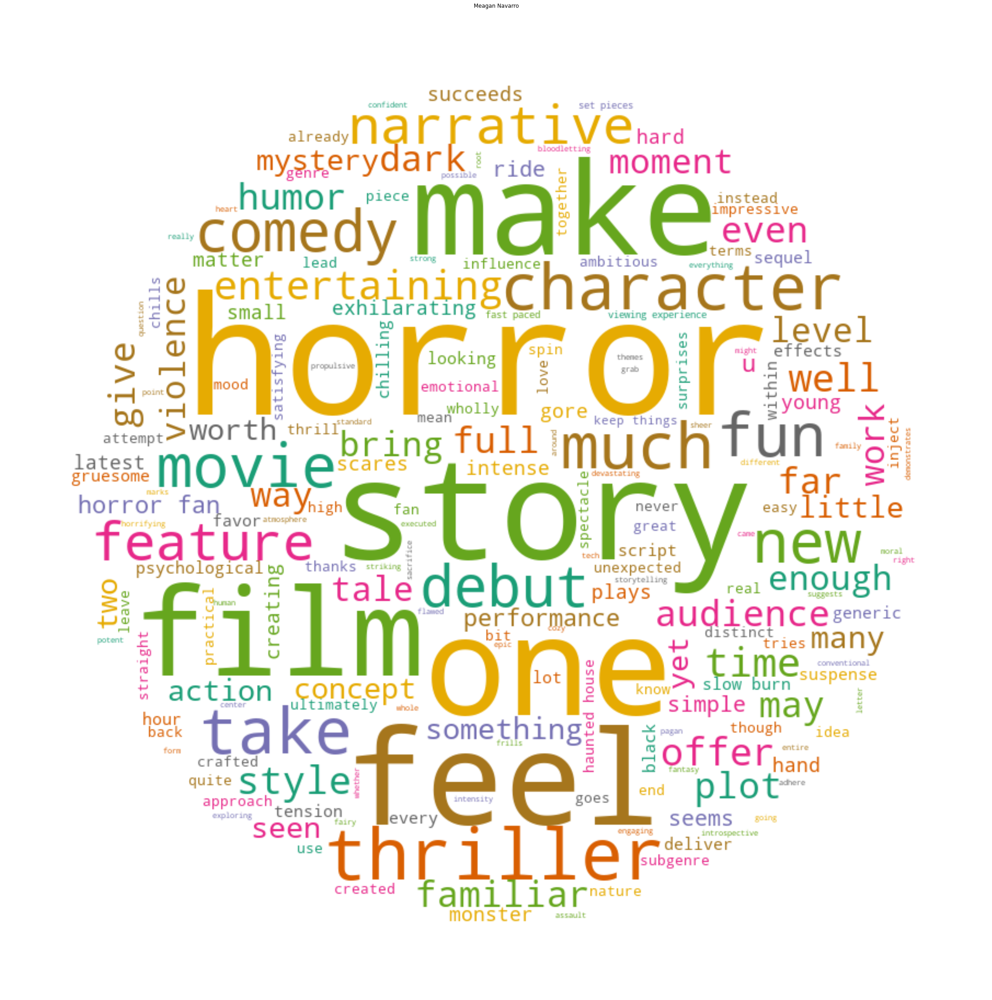

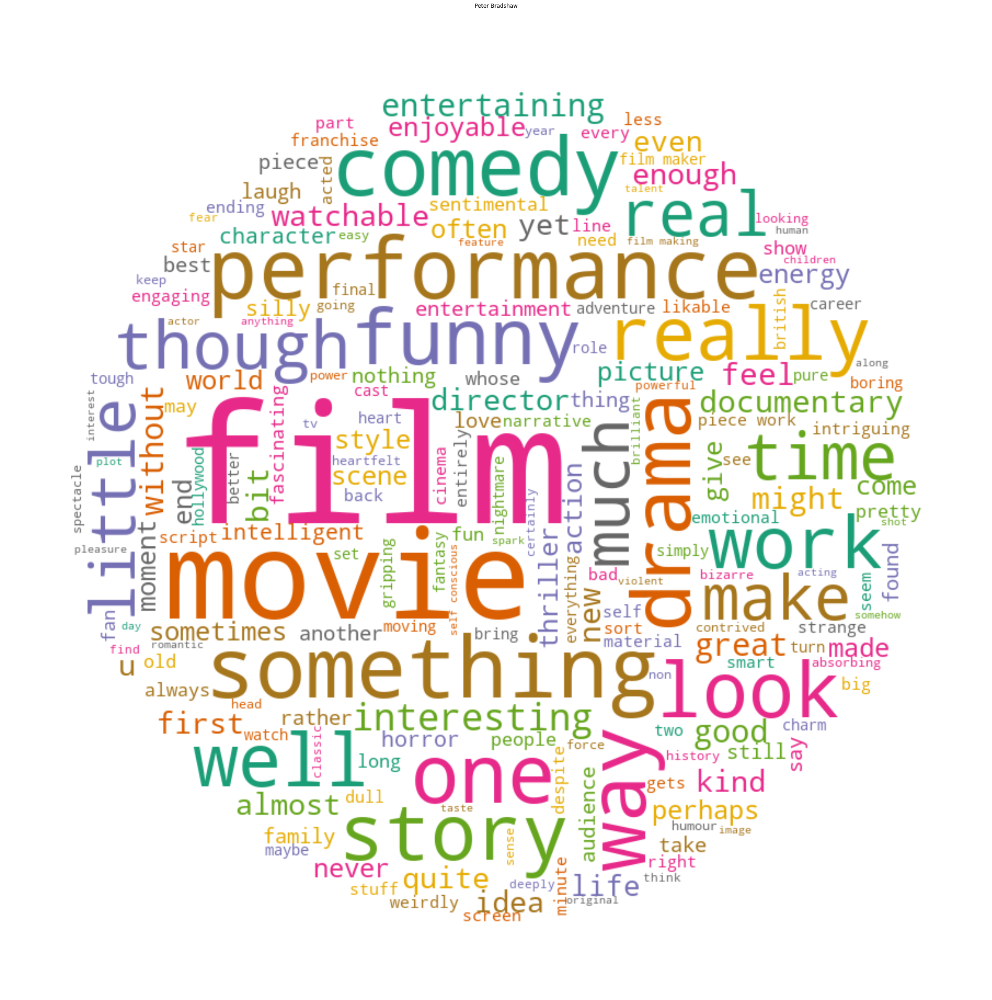

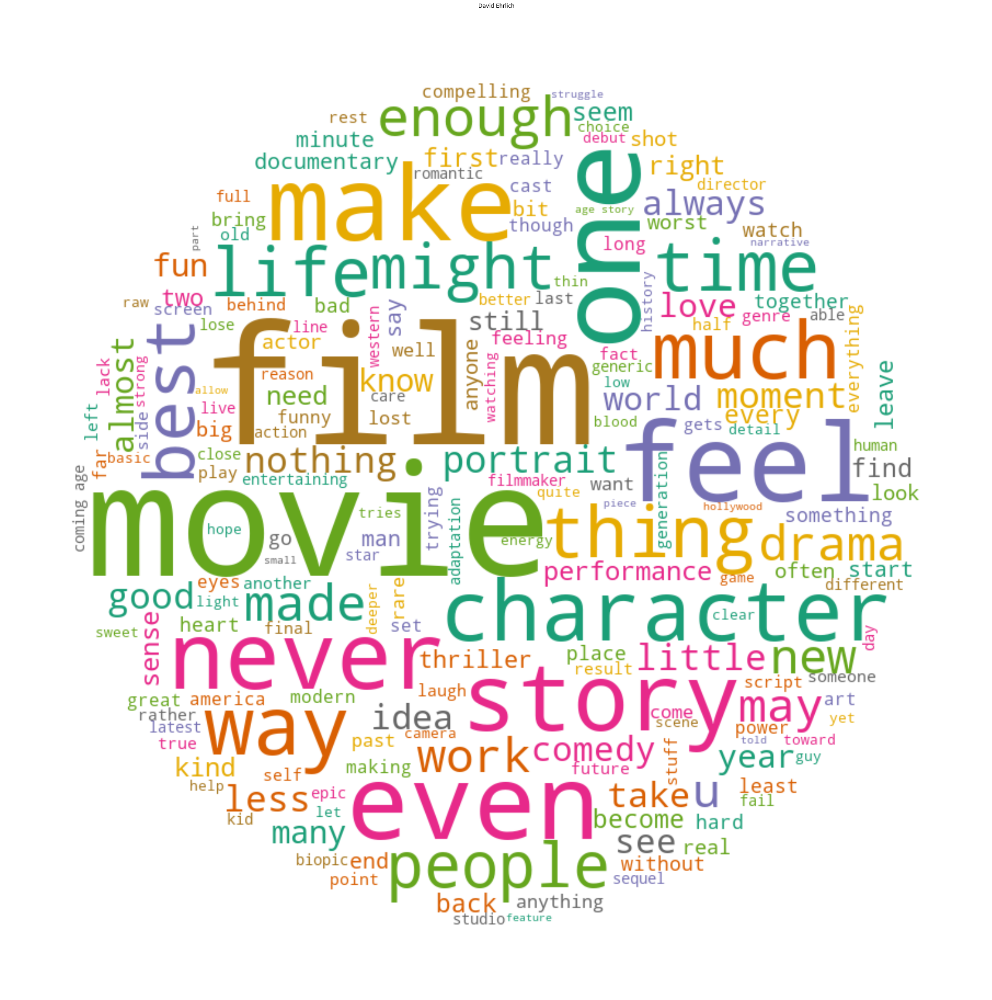

In [21]:
## by top reviewer to view their word preference
lists = df[df.top_critics]["reviewer"].unique()[:5]
wordcloud("freq", df, "reviewer", "cleaned_review", lists)

### 3. Tf-idf

#### 3.1. calculation

In [22]:
from sklearn.feature_extraction.text import TfidfVectorizer

cv = TfidfVectorizer()
tfidf = cv.fit_transform(df.cleaned_review)
# sum_tf = pd.DataFrame(tfidf.sum(axis=0))
tfidf.columns = cv.get_feature_names()
tfidf

<417058x84296 sparse matrix of type '<class 'numpy.float64'>'
	with 5053811 stored elements in Compressed Sparse Row format>

#### 3.2. Wordcloud based on Tf-Idf

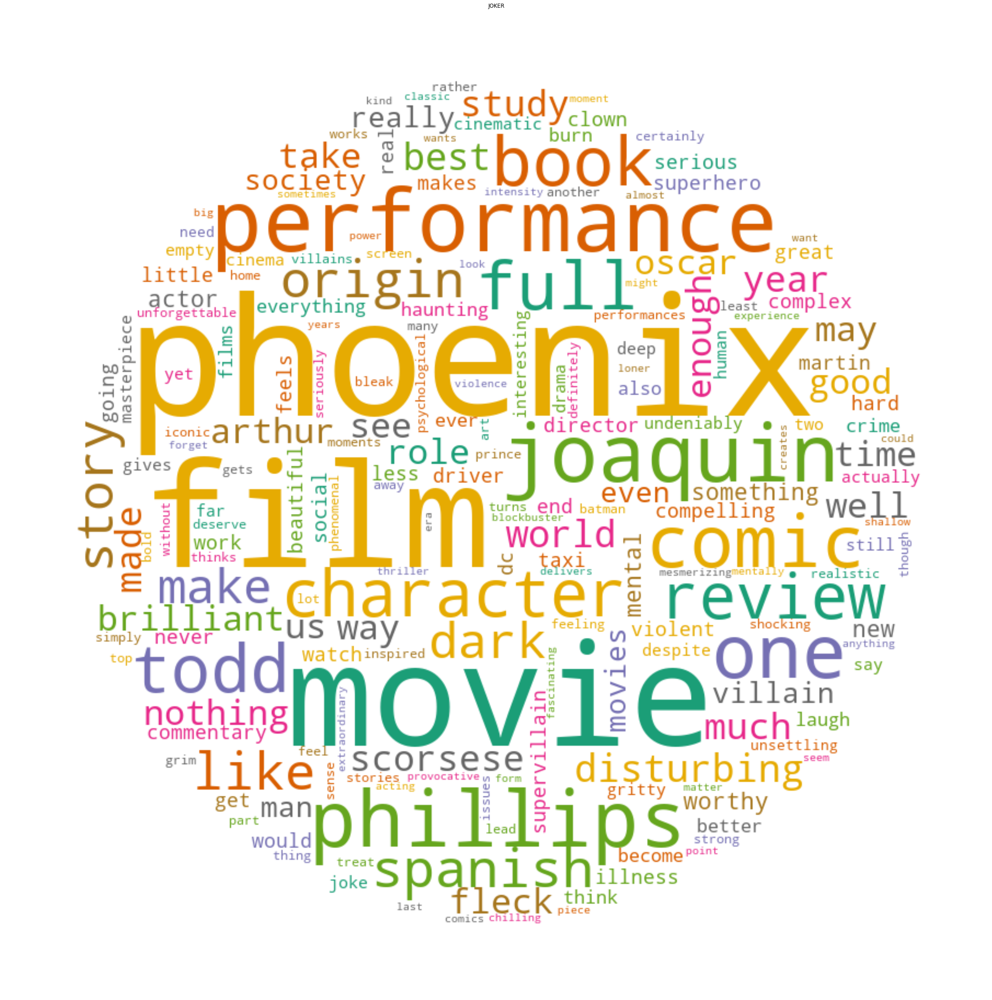

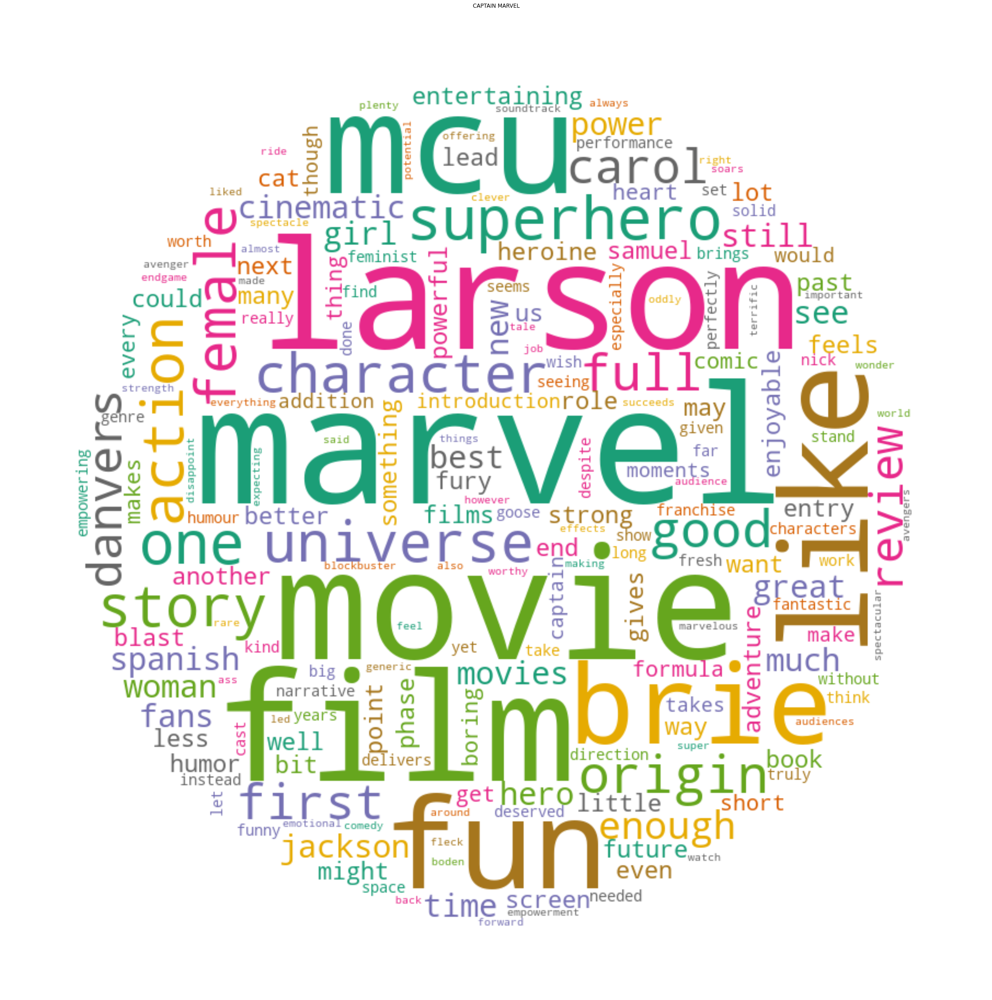

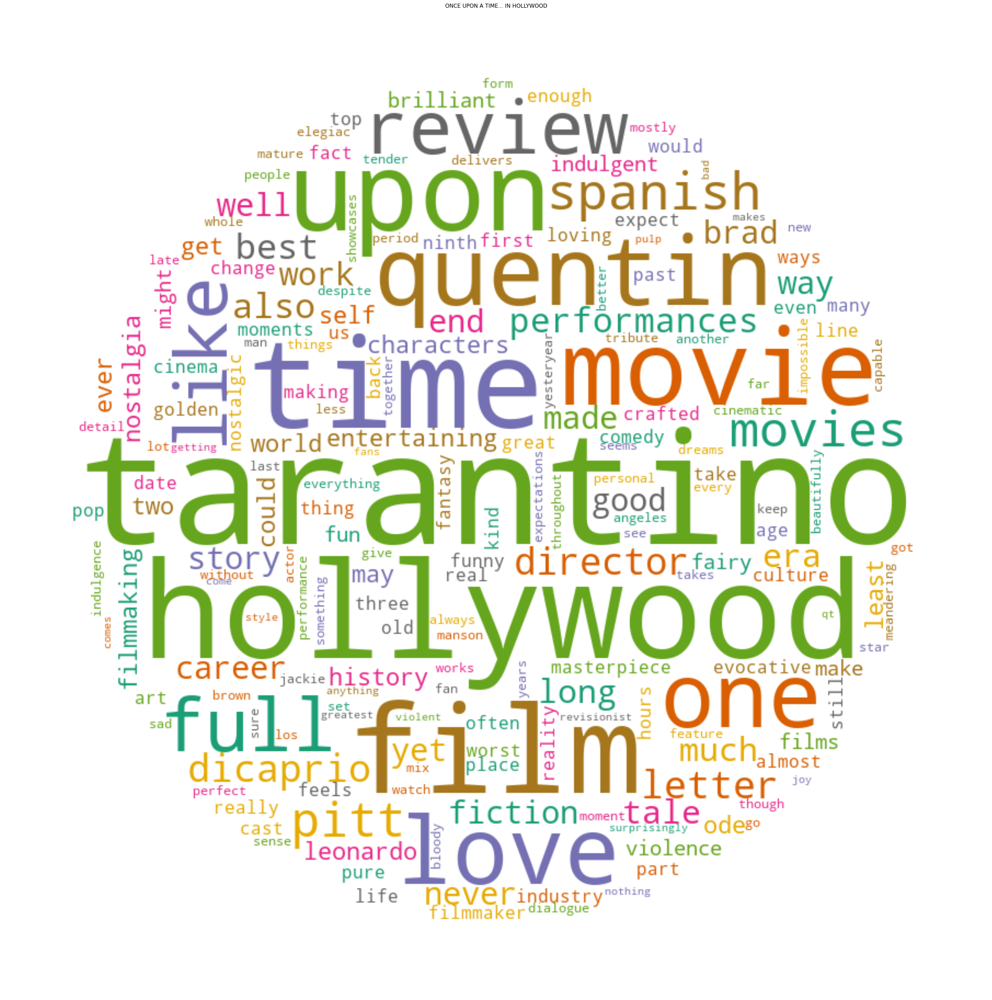

In [23]:
## code details could be found in the wordcloud() function
### per movie
movie_list = stats.index[:3].tolist()
wordcloud("tf-idf",df,"movie","cleaned_review",movie_list)

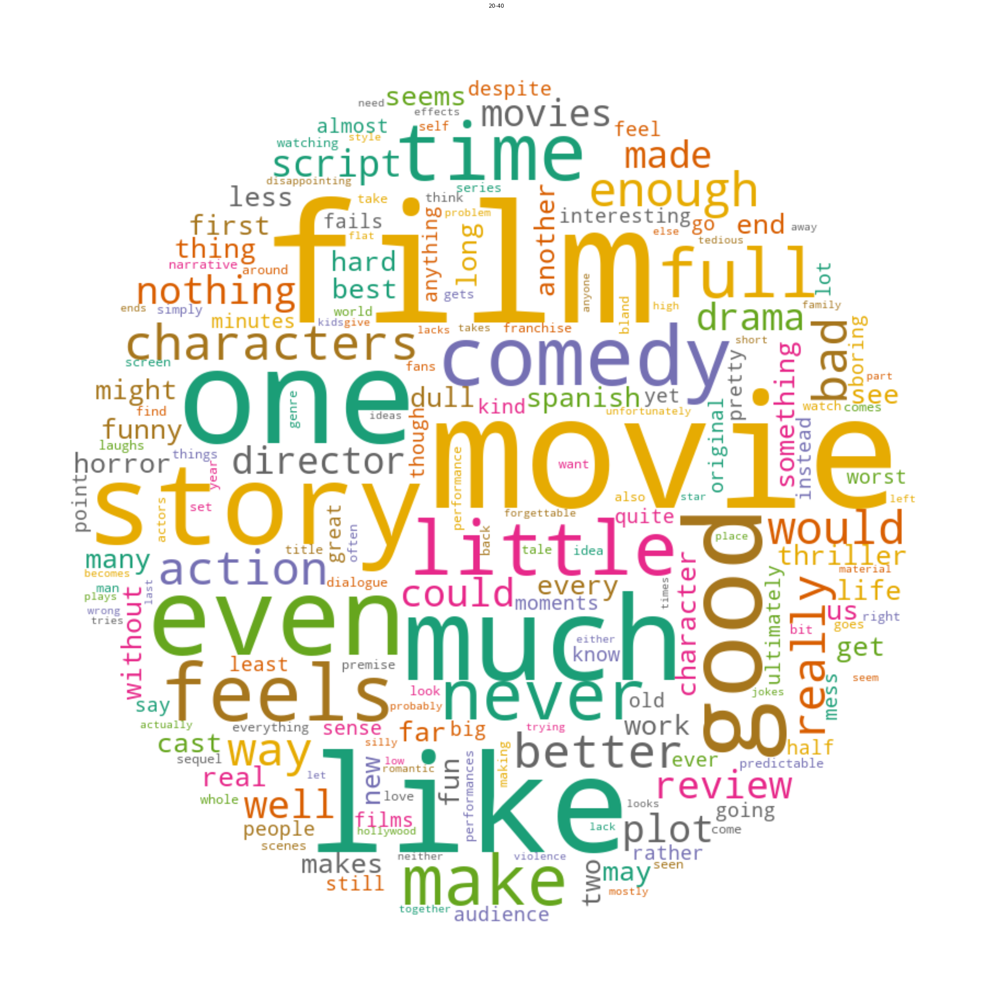

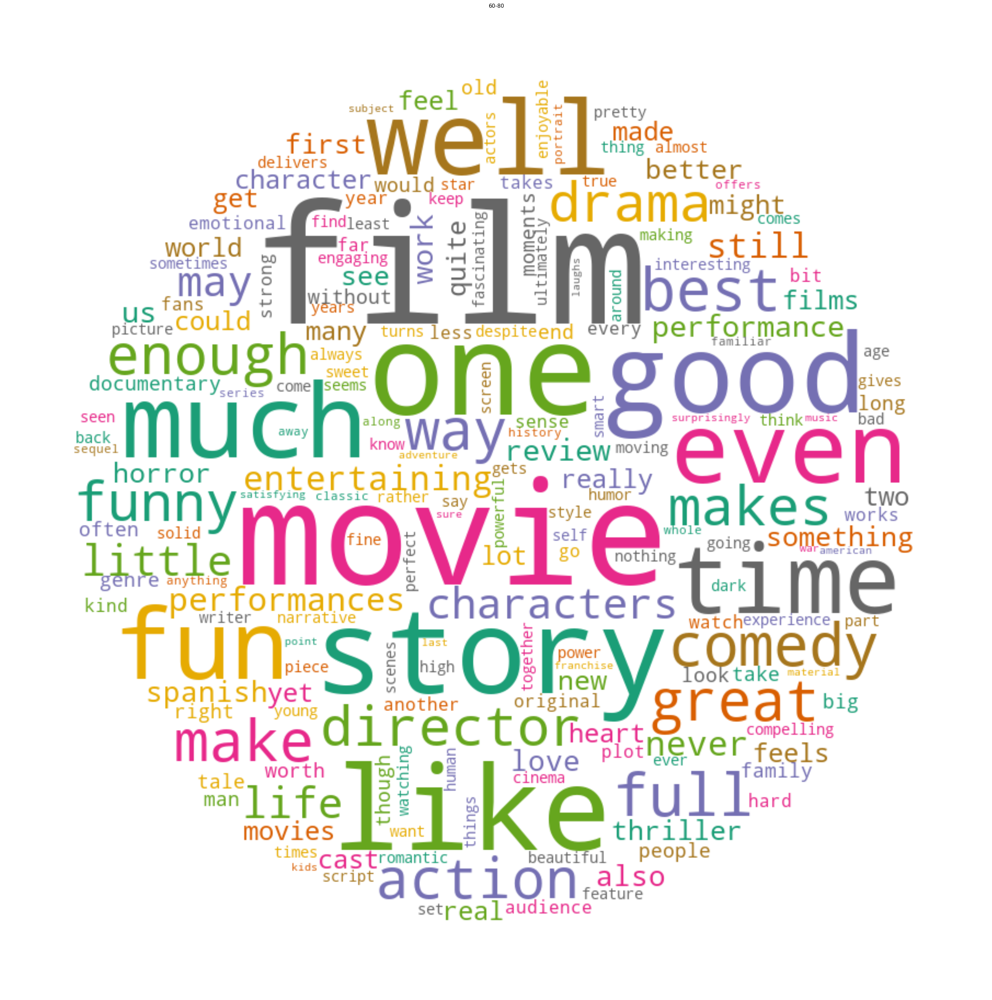

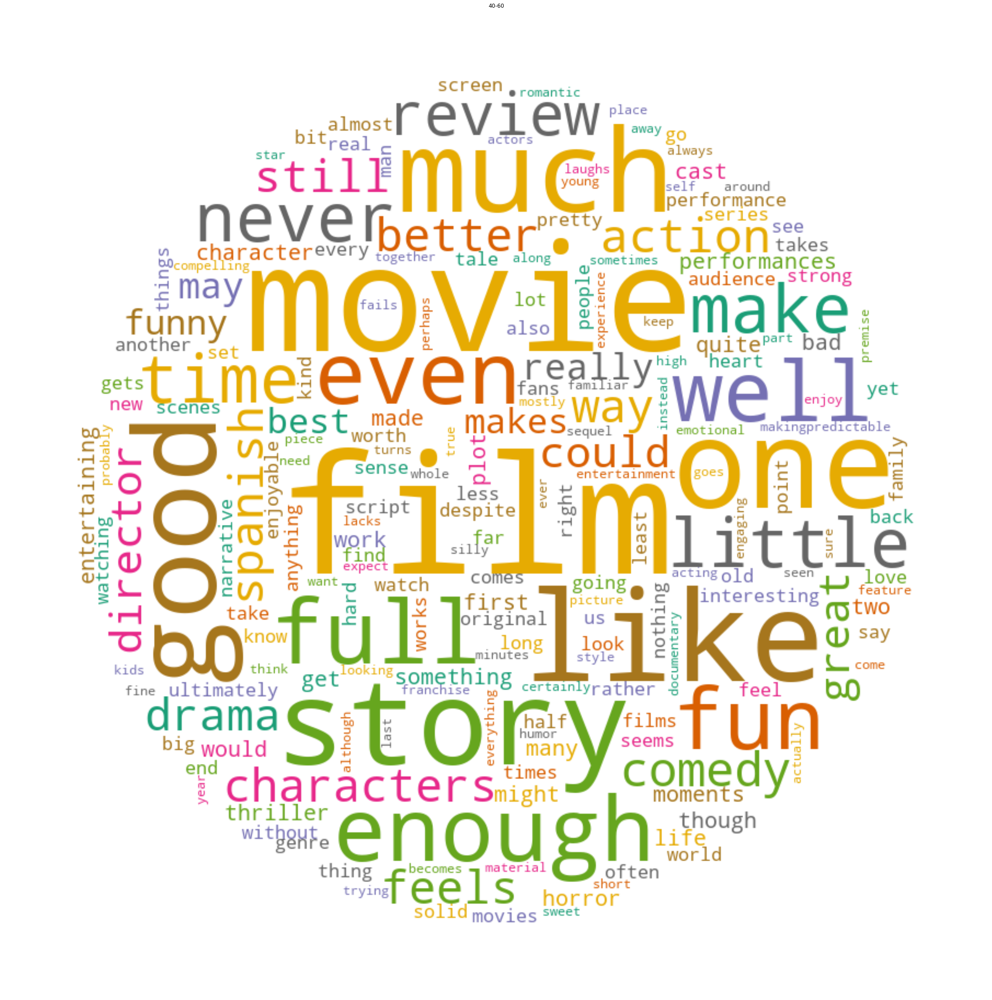

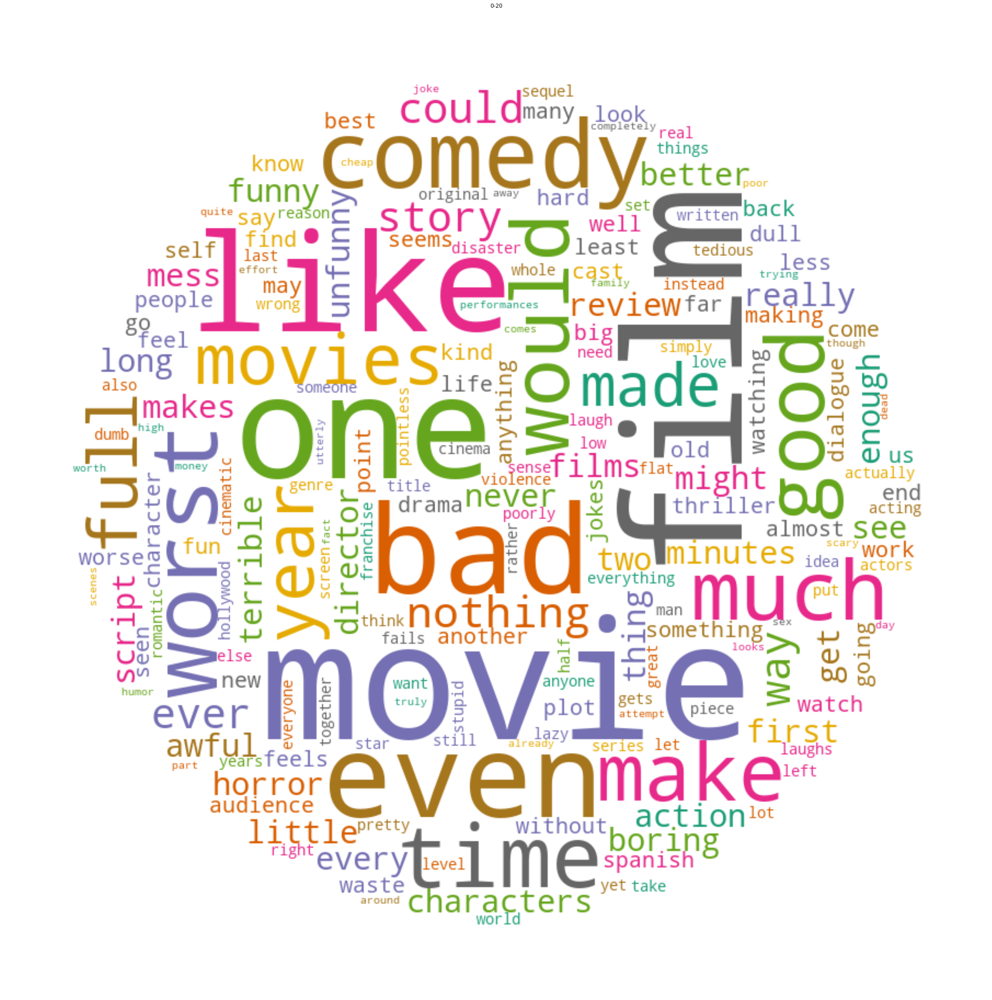

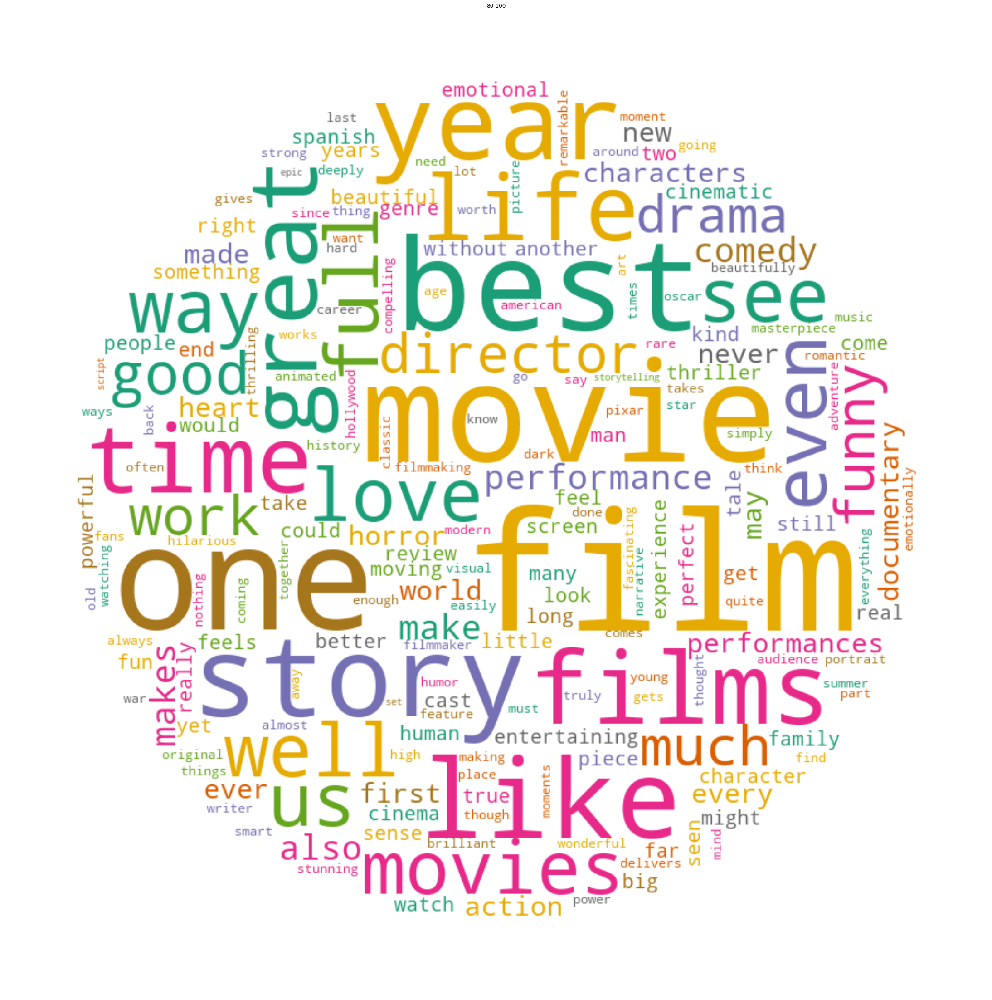

In [24]:
## per score interval
score_int = df.score_interval.unique()
wordcloud("tf-idf", df, "score_interval", "cleaned_review", score_int)

### 4. PCA

since the PCA for our large dataset is too complex and cost high memories, only 1000 PCs available on my computer. 36% variance explained. Data saved in "pcd_df.pk".

Suggest to pass this step.

In [25]:
# ## PCA code from lecture -- modified to sparse dataset
# ## function details see utils.py
# import time
# startTime = time.time()

# pca_red = sparse_pca_fun(tfidf, 1000, "./pickles/", "pca")
# split_pickles(pca_red, "./pickles/", "pca_df_", 8)

# executionTime = (time.time() - startTime)
# print('Execution time in seconds: ' + str(executionTime))
# print(executionTime)

Explained variance: 0.36744174444847244
Execution time in seconds: 268.80108165740967
268.80108165740967


In [ ]:
out_path = "./pickles/"
NUM_OF_PROCESSES = 8
pca_red = merge_pickle_dfs('pca_df_', NUM_OF_PROCESSES, out_path)

### 5. embedding??